In [1]:
import sys
import os
import numpy as np
from pathlib import Path
root = Path(os.getcwd()).parent.parent
sys.path.append(str(Path(os.getcwd()).parent))
np.set_printoptions(threshold=sys.maxsize, suppress=True)

In [2]:
from loader import DataType, Dataset, Power, Weather, Loader
from datetime import datetime, timedelta
import matplotlib.pyplot as plt
import pandas as pd
import argparse

## Setting

In [3]:
parser = argparse.ArgumentParser()
args = parser.parse_args("")

# ====== Data ====== #
args.years = [2017, 2018, 2019]
args.region = "Jindo"
args.station = 192

## Power

In [4]:
power_path = os.path.join(root, "data", "pow")

### 2017

In [5]:
power_file_path = os.path.join(power_path, "%s_%d_%d.csv" % (args.region, args.station, args.years[0]))
power_data = pd.read_csv(power_file_path, encoding='euc-kr')

In [6]:
power_data.head()

,년월일,호기,구분,총량,평균,최대,최소,최대(시간별),최소(시간별),1,...,15,16,17,18,19,20,21,22,23,24
0,2017.01.01,1,발전량,"1,181.00",49,223,0,223,4,0,...,122,33,5,0,0,0,0,0,0,0
1,2017.01.02,1,발전량,"1,067.00",44,220,0,220,2,0,...,63,21,3,0,0,0,0,0,0,0
2,2017.01.03,1,발전량,"1,193.00",50,227,0,227,3,0,...,124,34,4,0,0,0,0,0,0,0
3,2017.01.04,1,발전량,869,36,187,0,187,4,0,...,60,38,7,0,0,0,0,0,0,0
4,2017.01.05,1,발전량,577,24,109,0,109,2,0,...,39,15,3,0,0,0,0,0,0,0


In [7]:
# check missing dates
def check_missing_dates(year, power_data):
    date_checker = datetime.strptime("%d.01.01" % year, "%Y.%m.%d")
    dates = power_data['년월일']
    count = 0

    for index, value in dates.items():
        new_date = datetime.strptime(value, "%Y.%m.%d")
        if date_checker != new_date:
            print("standard: %s, file: %s" % (str(date_checker, str(new_date))))
            date_checker = new_date
            count += 1
        date_checker = date_checker + timedelta(days=1)
        
    print("%d missing dates" % count)
    
check_missing_dates(args.years[0], power_data)

0 missing dates


In [8]:
# check 24:00 values
def check_midnight_values(power_data):
    midnights = power_data['24']
    for index, value in midnights.items():
        count = 0
        if value != 0:
            print("index: %d, value: %d" % (index, value))
            count += 0
    print("%d value(s) are not zero" % count)
    
check_midnight_values(power_data)

0 value(s) are not zero


In [9]:
# convert dataframe to list
def convert_df_to_list(power_data, extra=1, zfill=1):
    power_data_list = []
    for index, row in power_data.iterrows():
        for i in range(1, 24):
            value = row[str(i).zfill(zfill)] * extra
            power_data_list.append(int(value))
        if index == 0: print(power_data_list)
        power_data_list.append(0)
        
    return power_data_list

power_data_2017 = convert_df_to_list(power_data)

[0, 0, 0, 0, 0, 0, 4, 28, 59, 125, 174, 223, 220, 188, 122, 33, 5, 0, 0, 0, 0, 0, 0]


In [10]:
power_data_2017

[0,
 0,
 0,
 0,
 0,
 0,
 4,
 28,
 59,
 125,
 174,
 223,
 220,
 188,
 122,
 33,
 5,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 2,
 24,
 60,
 121,
 163,
 215,
 220,
 175,
 63,
 21,
 3,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 3,
 22,
 67,
 124,
 168,
 227,
 225,
 195,
 124,
 34,
 4,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 4,
 22,
 49,
 79,
 129,
 168,
 187,
 126,
 60,
 38,
 7,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 2,
 22,
 62,
 90,
 109,
 101,
 82,
 52,
 39,
 15,
 3,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 1,
 25,
 61,
 123,
 172,
 224,
 224,
 195,
 134,
 35,
 3,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 4,
 25,
 47,
 81,
 117,
 102,
 79,
 97,
 36,
 18,
 2,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 1,
 16,
 46,
 106,
 79,
 96,
 99,
 170,
 134,
 41,
 6,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 2,
 24,
 42,
 71,
 163,
 210,
 214,
 186,
 133,
 43,
 6,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,


### 2018

In [11]:
power_file_path = os.path.join(power_path, "%s_%d_%d.csv" % (args.region, args.station, args.years[1]))
power_data = pd.read_csv(power_file_path, encoding='euc-kr')

In [12]:
power_data.head()

,년월일,호기,구분,총량,평균,최대,최소,최대(시간별),최소(시간별),1,...,15,16,17,18,19,20,21,22,23,24
0,2018.01.01,1,발전량,1.229,0.051,0.243,0,0.243,0.003,0,...,0.131,0.031,0.003,0.0,0.0,0.0,0,0,0,0
1,2018.01.02,1,발전량,1.034,0.043,0.195,0,0.195,0.004,0,...,0.097,0.030,0.004,0.0,0.0,0.0,0,0,0,0
2,2018.01.03,1,발전량,1.193,0.050,0.237,0,0.237,0.003,0,...,0.117,0.035,0.004,0.0,0.0,0.0,0,0,0,0
3,2018.01.04,1,발전량,0.859,0.036,0.206,0,0.206,0.001,0,...,0.051,0.018,0.001,0.0,0.0,0.0,0,0,0,0
4,2018.01.05,1,발전량,1.197,0.050,0.229,0,0.229,0.002,0,...,0.134,0.035,0.006,0.0,0.0,0.0,0,0,0,0


In [13]:
check_missing_dates(args.years[1], power_data)
check_midnight_values(power_data)

0 missing dates
0 value(s) are not zero


In [14]:
power_data_2018 = convert_df_to_list(power_data, 1000)

[0, 0, 0, 0, 0, 0, 3, 21, 63, 123, 180, 233, 243, 198, 131, 31, 3, 0, 0, 0, 0, 0, 0]


In [15]:
power_data_2018

[0,
 0,
 0,
 0,
 0,
 0,
 3,
 21,
 63,
 123,
 180,
 233,
 243,
 198,
 131,
 31,
 3,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 4,
 22,
 61,
 115,
 159,
 192,
 195,
 154,
 96,
 30,
 4,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 3,
 20,
 63,
 129,
 170,
 237,
 230,
 185,
 117,
 35,
 4,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 3,
 20,
 51,
 86,
 147,
 206,
 159,
 117,
 51,
 18,
 1,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 2,
 18,
 57,
 128,
 166,
 221,
 228,
 200,
 134,
 35,
 6,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 3,
 19,
 62,
 127,
 182,
 239,
 246,
 203,
 143,
 40,
 3,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 3,
 23,
 40,
 47,
 64,
 61,
 39,
 63,
 59,
 17,
 2,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 12,
 18,
 27,
 42,
 43,
 32,
 25,
 19,
 10,
 2,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 4,
 22,
 36,
 78,
 71,
 85,
 88,
 180,
 92,
 21,
 8,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 

### 2019

In [16]:
power_file_path = os.path.join(power_path, "%s_%d_%d.csv" % (args.region, args.station, args.years[2]))
power_data = pd.read_csv(power_file_path, encoding='euc-kr')

In [17]:
power_data.head()

,년월일,호기,구분,총량,평균,최대,최소,최대(시간별),최소(시간별),01,...,15,16,17,18,19,20,21,22,23,24
0,2019.01.01,1,발전량,"1,039.000",43.0,226.0,0.0,226.0,4.0,0.0,...,126.0,92.0,20.0,4.0,0.0,0.0,0.0,0.0,0.0,0.0
1,2019.01.02,1,발전량,"1,177.000",49.0,235.0,0.0,235.0,4.0,0.0,...,120.0,31.0,4.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,2019.01.03,1,발전량,"1,155.000",48.0,230.0,0.0,230.0,2.0,0.0,...,114.0,30.0,5.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,2019.01.04,1,발전량,542.000,23.0,116.0,0.0,116.0,2.0,0.0,...,35.0,17.0,3.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,2019.01.05,1,발전량,851.000,35.0,180.0,0.0,180.0,2.0,0.0,...,94.0,31.0,5.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [18]:
check_missing_dates(args.years[2], power_data)
check_midnight_values(power_data)

0 missing dates
0 value(s) are not zero


In [19]:
power_data_2019 = convert_df_to_list(power_data, zfill=2)

[0, 0, 0, 0, 0, 0, 5, 22, 57, 117, 159, 0, 211, 226, 126, 92, 20, 4, 0, 0, 0, 0, 0]


In [20]:
power_data_2019

[0,
 0,
 0,
 0,
 0,
 0,
 5,
 22,
 57,
 117,
 159,
 0,
 211,
 226,
 126,
 92,
 20,
 4,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 4,
 22,
 58,
 122,
 176,
 229,
 235,
 176,
 120,
 31,
 4,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 2,
 20,
 62,
 122,
 172,
 230,
 229,
 169,
 114,
 30,
 5,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 2,
 20,
 56,
 96,
 116,
 51,
 76,
 70,
 35,
 17,
 3,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 2,
 22,
 46,
 93,
 131,
 98,
 180,
 149,
 94,
 31,
 5,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 4,
 21,
 50,
 112,
 172,
 227,
 233,
 171,
 116,
 37,
 4,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 3,
 24,
 59,
 100,
 147,
 189,
 203,
 147,
 93,
 36,
 6,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 4,
 21,
 60,
 109,
 159,
 203,
 208,
 136,
 106,
 36,
 5,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 3,
 32,
 60,
 117,
 160,
 184,
 106,
 66,
 49,
 34,
 3,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 

### all

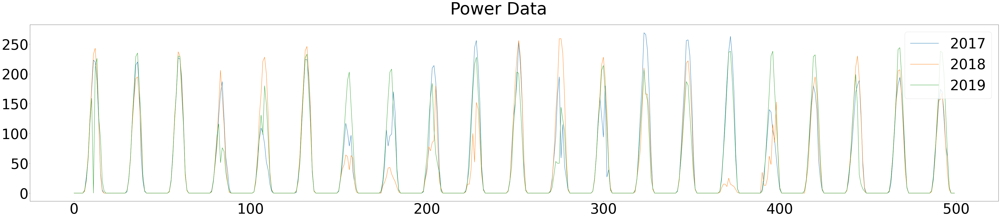

In [24]:
def plot_power(y_values):
    plt.rcParams.update({'font.size': 65})
    plt.figure(figsize=(80, 15))
    
    for index, y_value in enumerate(y_values):
        plt.plot(y_value[:500], label='%d' % (index + 2017))
        
    plt.suptitle("Power Data")
    plt.legend()
    plt.show()
    
plot_power([power_data_2017, power_data_2018, power_data_2019])

## Weather

In [138]:
# set korean for matplotlib
from matplotlib import font_manager, rc
font_name = font_manager.FontProperties(fname="c:/Windows/Fonts/malgun.ttf").get_name()
rc('font', family=font_name)

In [139]:
weather_path = os.path.join(root, "data", "weather")

In [140]:
from constant import FeatureType

features = [FeatureType.SUNSHINE,
                 FeatureType.HUMIDITY,
                 FeatureType.WIND_SPEED,
                 FeatureType.VISIBILITY,
                 FeatureType.GROUND_TEMPERATURE,
                 FeatureType.WIND_DIRECTION,
                 FeatureType.STEAM_PRESSURE,
                 FeatureType.TEMPERATURE,
                 FeatureType.PRECIPITATION,
                 FeatureType.DEW_POINT_TEMPERATURE,
                 FeatureType.ATMOSPHERIC_PRESSURE]

### 2017

In [141]:
year = args.years[0]
filename = "SURFACE_ASOS_%d_HR_%d_%d_%d.csv" % (args.station, year, year, year + 1)
weather_file_path = os.path.join(weather_path, filename)
weather_data = pd.read_csv(weather_file_path, encoding='euc-kr')

In [142]:
weather_data.head()

,지점,일시,기온(°C),강수량(mm),풍속(m/s),풍향(16방위),습도(%),증기압(hPa),이슬점온도(°C),현지기압(hPa),...,운형(운형약어),최저운고(100m ),시정(10m),지면상태(지면상태코드),현상번호(국내식),지면온도(°C),5cm 지중온도(°C),10cm 지중온도(°C),20cm 지중온도(°C),30cm 지중온도(°C)
0,192,2017-01-01 00:00,-2.4,NaN,0.0,0,85,4.4,-4.5,1026.5,...,NaN,NaN,720.0,NaN,NaN,-1.3,NaN,NaN,NaN,NaN
1,192,2017-01-01 01:00,-3.0,NaN,0.1,0,86,4.2,-5.0,1026.2,...,NaN,NaN,700.0,NaN,NaN,-1.5,NaN,NaN,NaN,NaN
2,192,2017-01-01 02:00,-3.1,NaN,0.0,0,87,4.2,-4.9,1026.6,...,NaN,NaN,637.0,NaN,NaN,-1.7,NaN,NaN,NaN,NaN
3,192,2017-01-01 03:00,-3.5,NaN,0.1,0,88,4.2,-5.2,1026.8,...,NaN,NaN,626.0,NaN,NaN,-1.8,NaN,NaN,NaN,NaN
4,192,2017-01-01 04:00,-3.6,NaN,0.3,0,88,4.1,-5.3,1026.2,...,NaN,NaN,573.0,NaN,NaN,-1.9,NaN,NaN,NaN,NaN


In [143]:
# check missing hours
def check_missing_dates(year, weather_data):
    weather_data['일시'] = pd.to_datetime(weather_data['일시'], format='%Y-%m-%d %H:%M')
    full_idx = pd.date_range(start=weather_data['일시'].min(), end=weather_data['일시'].max(), freq='60T')

    missing_hour_filled_weather = weather_data.set_index('일시').reindex(full_idx).rename_axis('일시').reset_index()

    start_date = datetime.strptime("%d-01-01 00:00" % year, '%Y-%m-%d %H:%M')
    missing_dates = missing_hour_filled_weather['일시'].isin(weather_data['일시'])
    missing_dates = [(start_date + timedelta(hours=i)).strftime('%Y-%m-%d %H:%M') for i, val in enumerate(missing_dates) if not val] 

    print("missing dates:", missing_dates)
    return missing_hour_filled_weather

weather_data = check_missing_dates(year, weather_data)

missing dates: []


C:\Users\VISLAB\anaconda3\envs\SolarPowerPrediction\lib\site-packages\ipykernel_launcher.py:15: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  from ipykernel import kernelapp as app


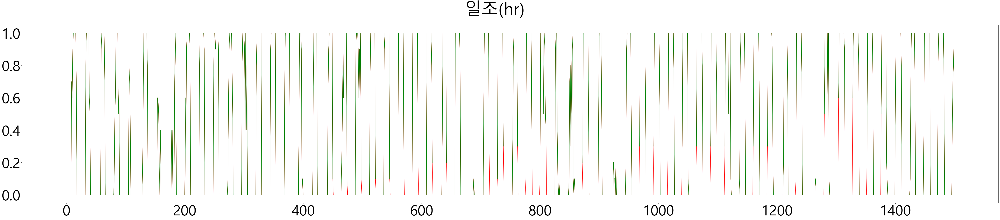

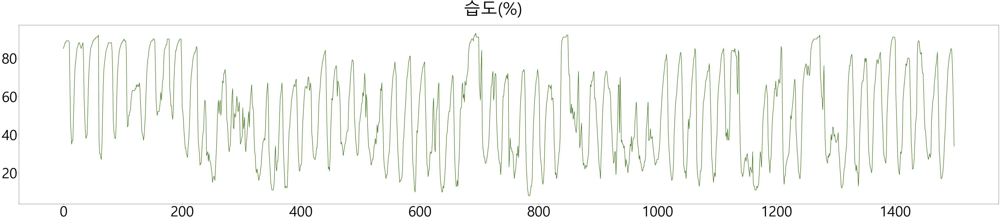

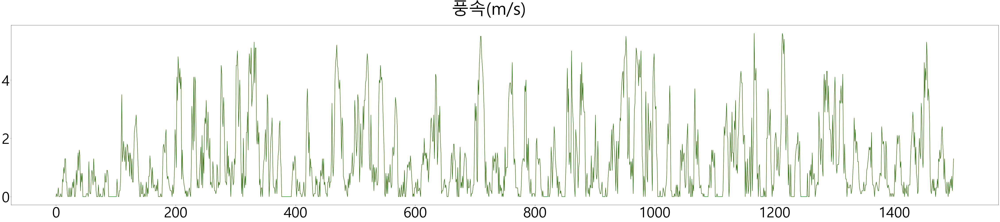

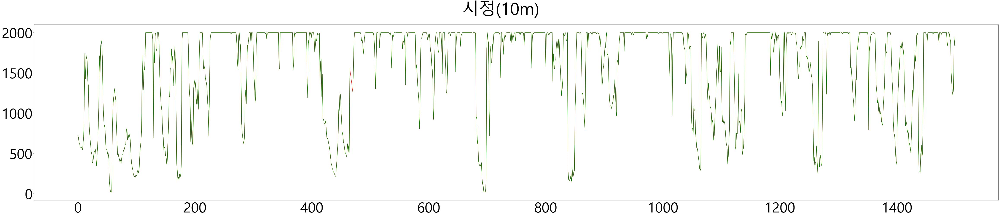

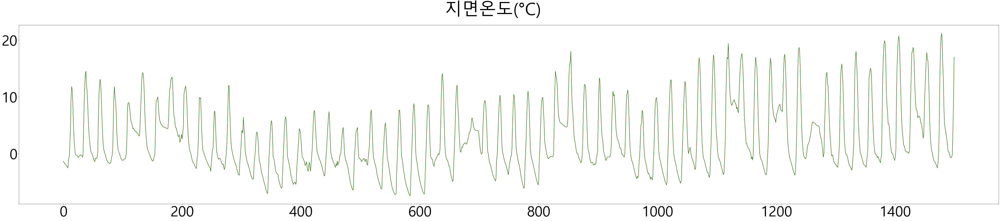

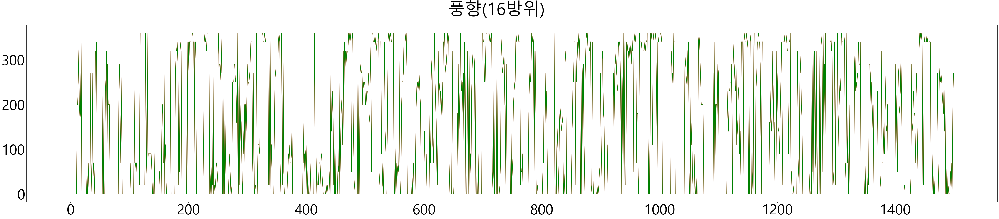

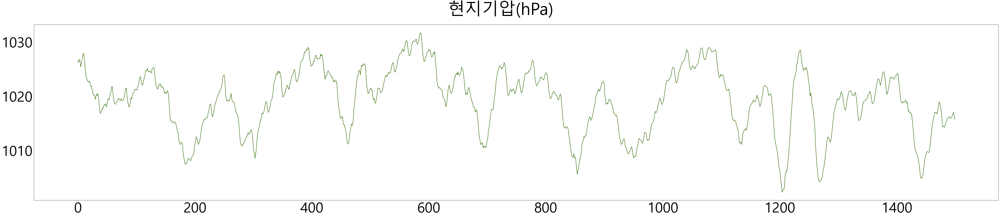

C:\Users\VISLAB\anaconda3\envs\SolarPowerPrediction\lib\site-packages\matplotlib\backends\backend_agg.py:238: RuntimeWarning: Glyph 8722 missing from current font.
  font.set_text(s, 0.0, flags=flags)
C:\Users\VISLAB\anaconda3\envs\SolarPowerPrediction\lib\site-packages\matplotlib\backends\backend_agg.py:201: RuntimeWarning: Glyph 8722 missing from current font.
  font.set_text(s, 0, flags=flags)


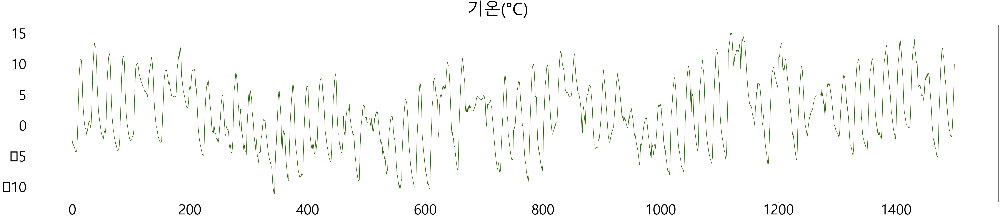

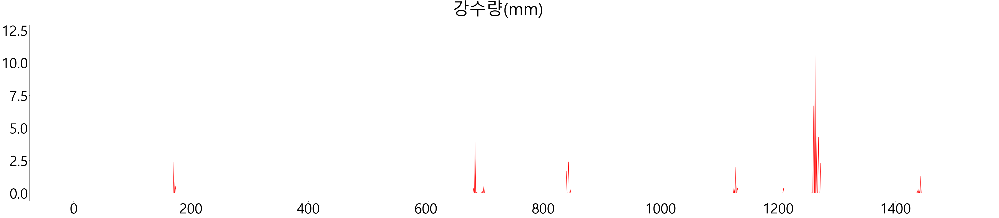

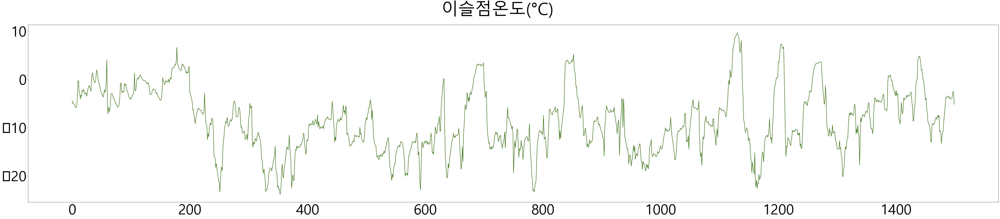

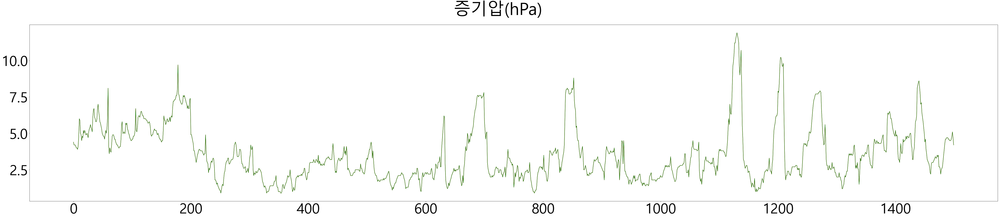

In [144]:
# check nan and interpolate
def interpolate_weather(weather_data, features):
    weather_df = pd.DataFrame()
    for feature in features:
        weather_raw = weather_data[feature.value]
        if feature == FeatureType.PRECIPITATION or feature == FeatureType.SUNSHINE:
            weather_feature = weather_data[feature.value].fillna(0)
        else:
            weather_feature = weather_data[feature.value]
        weather_feature = weather_feature.interpolate(mathoed='linear')
        weather_df[feature.value] = weather_feature

        fig = plt.figure(figsize=(80, 15))
        fig.add_subplot(1,1,1).plot(weather_feature[:1500], 'r')
        fig.add_subplot(1,1,1).plot(weather_raw[:1500], 'g')
        plt.suptitle(feature.value)
        plt.show()
    return weather_df

weather_data_2017 = interpolate_weather(weather_data, features)

### 2018

In [145]:
year = args.years[1]
filename = "SURFACE_ASOS_%d_HR_%d_%d_%d.csv" % (args.station, year, year, year + 1)
weather_file_path = os.path.join(weather_path, filename)
weather_data = pd.read_csv(weather_file_path, encoding='euc-kr')

In [146]:
weather_data.head()

,지점,일시,기온(°C),강수량(mm),풍속(m/s),풍향(16방위),습도(%),증기압(hPa),이슬점온도(°C),현지기압(hPa),...,운형(운형약어),최저운고(100m ),시정(10m),지면상태(지면상태코드),현상번호(국내식),지면온도(°C),5cm 지중온도(°C),10cm 지중온도(°C),20cm 지중온도(°C),30cm 지중온도(°C)
0,192,2018-01-01 00:00,-0.2,NaN,0.7,360.0,39.0,2.3,-12.5,1021.5,...,NaN,NaN,2000.0,NaN,NaN,-2.8,NaN,NaN,NaN,NaN
1,192,2018-01-01 01:00,-2.1,NaN,0.5,340.0,51.0,2.7,-10.9,1021.3,...,NaN,NaN,1991.0,NaN,NaN,-3.3,NaN,NaN,NaN,NaN
2,192,2018-01-01 02:00,-3.6,NaN,0.1,0.0,62.0,2.9,-9.8,1021.5,...,NaN,NaN,1699.0,NaN,NaN,-3.7,NaN,NaN,NaN,NaN
3,192,2018-01-01 03:00,-3.9,NaN,0.4,0.0,65.0,3.0,-9.5,1022.1,...,NaN,NaN,1706.0,NaN,NaN,-4.2,NaN,NaN,NaN,NaN
4,192,2018-01-01 04:00,-4.9,NaN,0.2,0.0,71.0,3.0,-9.3,1022.2,...,NaN,NaN,1690.0,NaN,NaN,-4.6,NaN,NaN,NaN,NaN


missing dates: ['2018-01-13 09:00', '2018-01-13 10:00', '2018-01-13 11:00', '2018-01-13 12:00', '2018-01-13 13:00']


C:\Users\VISLAB\anaconda3\envs\SolarPowerPrediction\lib\site-packages\ipykernel_launcher.py:15: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  from ipykernel import kernelapp as app


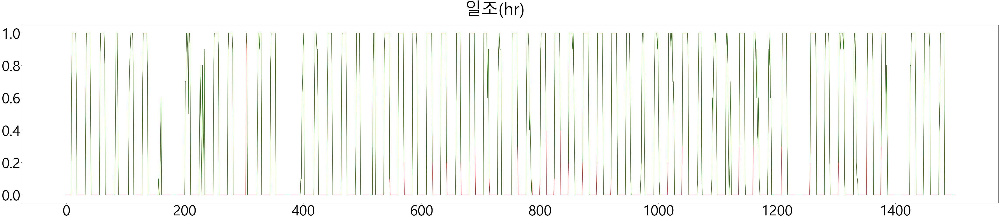

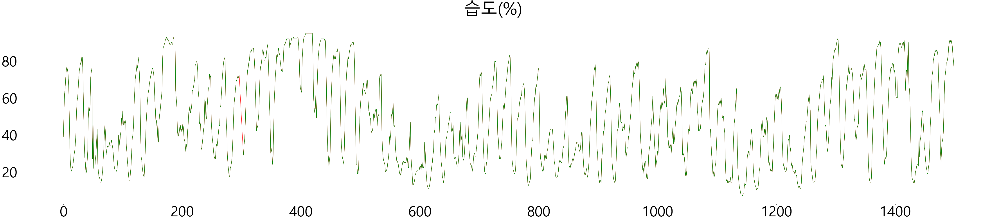

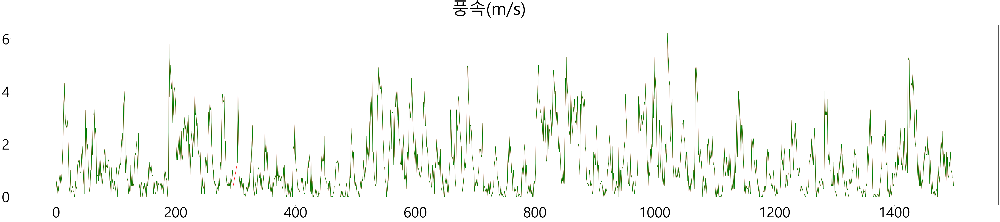

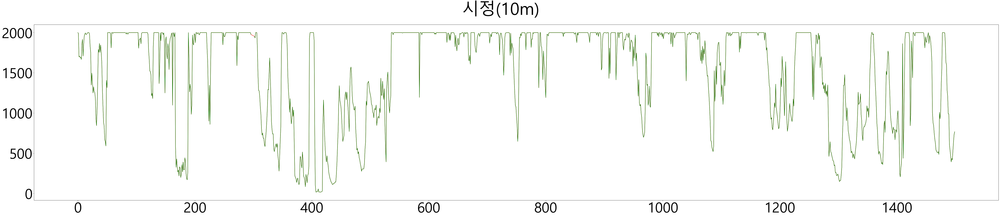

C:\Users\VISLAB\anaconda3\envs\SolarPowerPrediction\lib\site-packages\matplotlib\backends\backend_agg.py:238: RuntimeWarning: Glyph 8722 missing from current font.
  font.set_text(s, 0.0, flags=flags)
C:\Users\VISLAB\anaconda3\envs\SolarPowerPrediction\lib\site-packages\matplotlib\backends\backend_agg.py:201: RuntimeWarning: Glyph 8722 missing from current font.
  font.set_text(s, 0, flags=flags)


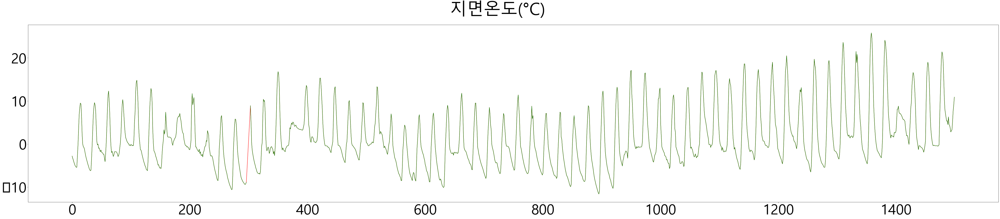

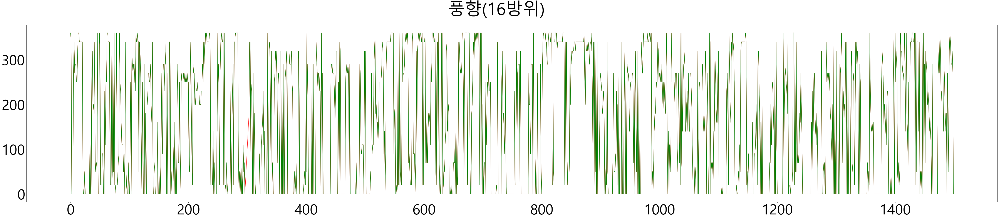

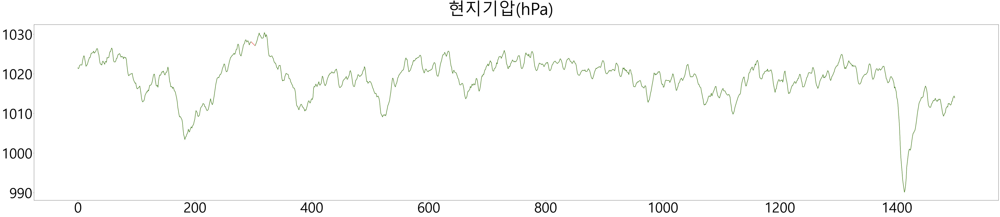

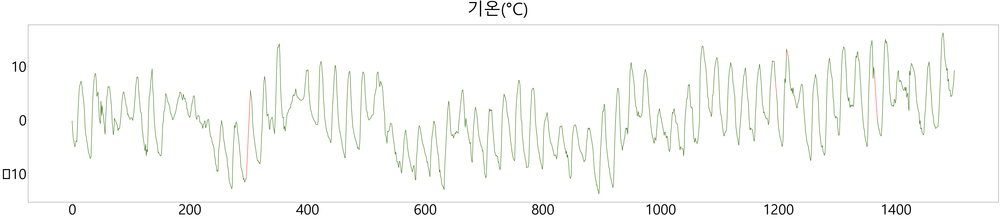

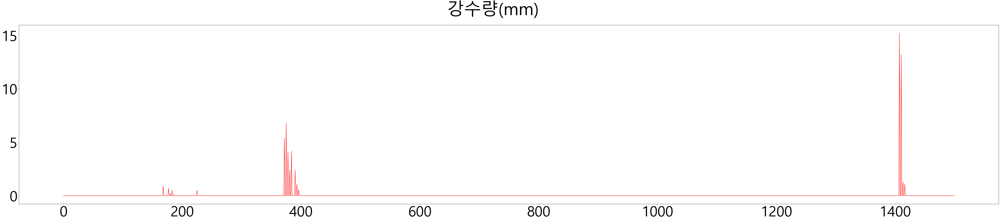

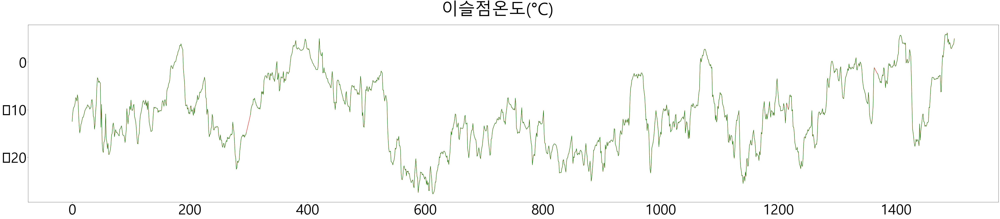

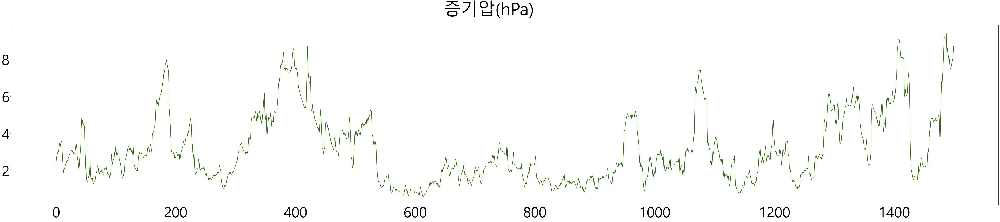

In [147]:
weather_data = check_missing_dates(year, weather_data)
weather_data_2018 = interpolate_weather(weather_data, features)

### 2019

In [148]:
year = args.years[2]
filename = "SURFACE_ASOS_%d_HR_%d_%d_%d.csv" % (args.station, year, year, year + 1)
weather_file_path = os.path.join(weather_path, filename)
weather_data = pd.read_csv(weather_file_path, encoding='euc-kr')

In [149]:
weather_data.head()

,지점,일시,기온(°C),강수량(mm),풍속(m/s),풍향(16방위),습도(%),증기압(hPa),이슬점온도(°C),현지기압(hPa),...,운형(운형약어),최저운고(100m ),시정(10m),지면상태(지면상태코드),현상번호(국내식),지면온도(°C),5cm 지중온도(°C),10cm 지중온도(°C),20cm 지중온도(°C),30cm 지중온도(°C)
0,192,2019-01-01 00:00,-5.7,NaN,0.3,0.0,49.0,2.0,-14.7,1029.8,...,NaN,NaN,2000.0,NaN,NaN,-6.3,NaN,NaN,NaN,NaN
1,192,2019-01-01 01:00,-5.9,NaN,0.6,50.0,49.0,1.9,-14.9,1029.4,...,NaN,NaN,2000.0,NaN,NaN,-7.0,NaN,NaN,NaN,NaN
2,192,2019-01-01 02:00,-6.5,NaN,0.5,50.0,50.0,1.9,-15.2,1029.6,...,NaN,NaN,2000.0,NaN,NaN,-7.4,NaN,NaN,NaN,NaN
3,192,2019-01-01 03:00,-7.2,NaN,0.1,0.0,57.0,2.0,-14.2,1029.7,...,NaN,NaN,2000.0,NaN,NaN,-7.7,NaN,NaN,NaN,NaN
4,192,2019-01-01 04:00,-7.4,NaN,0.2,0.0,58.0,2.0,-14.2,1029.0,...,NaN,NaN,1979.0,NaN,NaN,-7.8,NaN,NaN,NaN,NaN


missing dates: []


C:\Users\VISLAB\anaconda3\envs\SolarPowerPrediction\lib\site-packages\ipykernel_launcher.py:15: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  from ipykernel import kernelapp as app


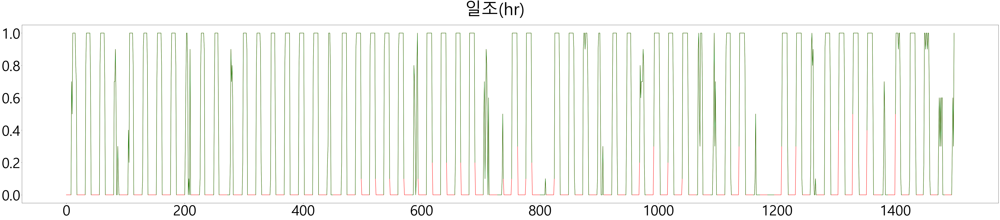

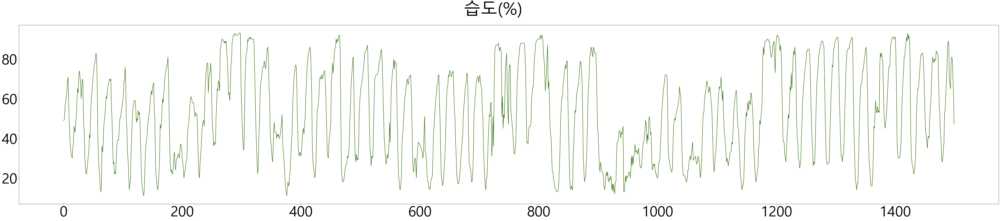

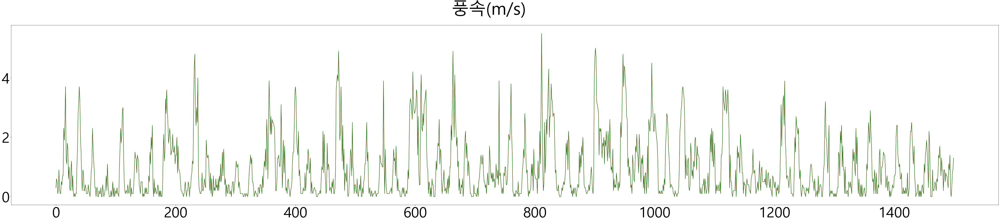

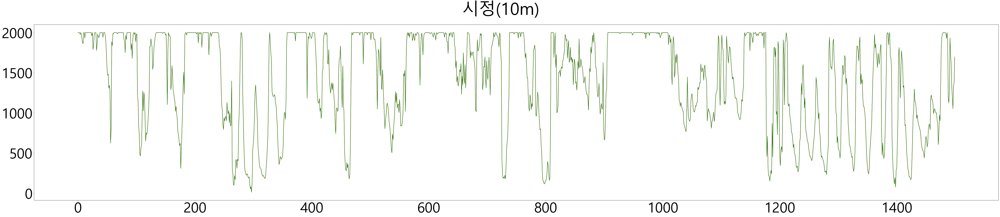

C:\Users\VISLAB\anaconda3\envs\SolarPowerPrediction\lib\site-packages\matplotlib\backends\backend_agg.py:238: RuntimeWarning: Glyph 8722 missing from current font.
  font.set_text(s, 0.0, flags=flags)
C:\Users\VISLAB\anaconda3\envs\SolarPowerPrediction\lib\site-packages\matplotlib\backends\backend_agg.py:201: RuntimeWarning: Glyph 8722 missing from current font.
  font.set_text(s, 0, flags=flags)


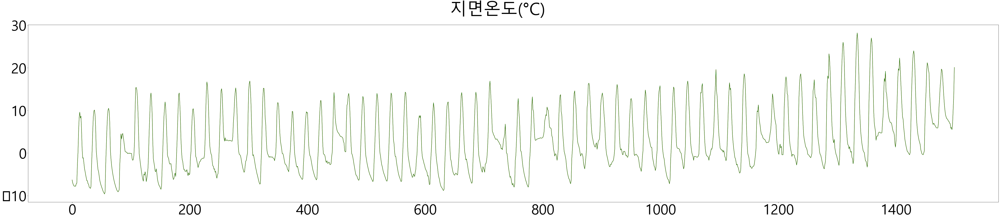

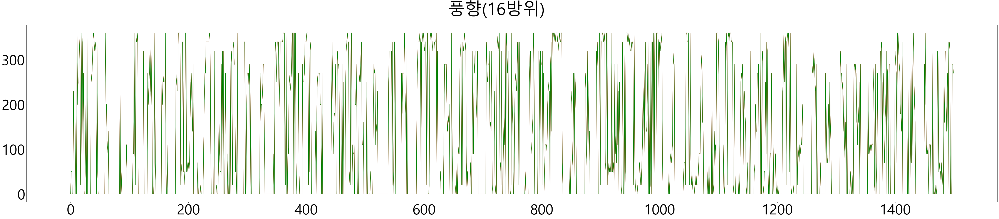

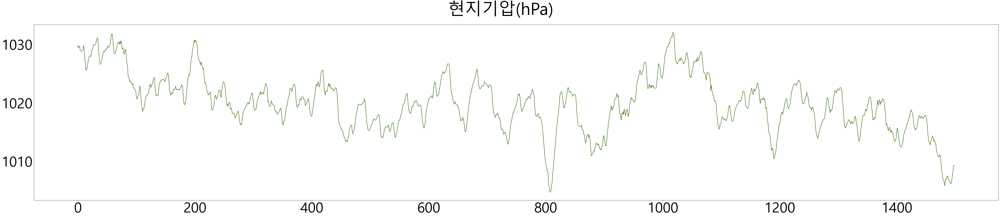

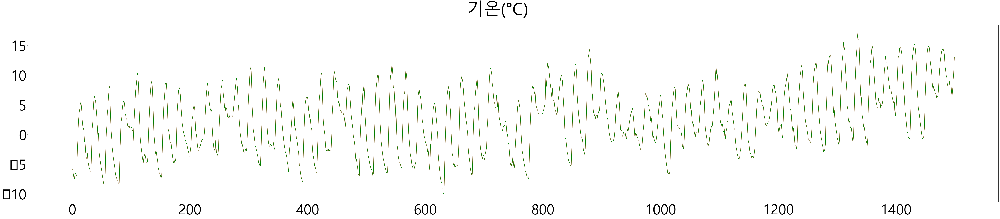

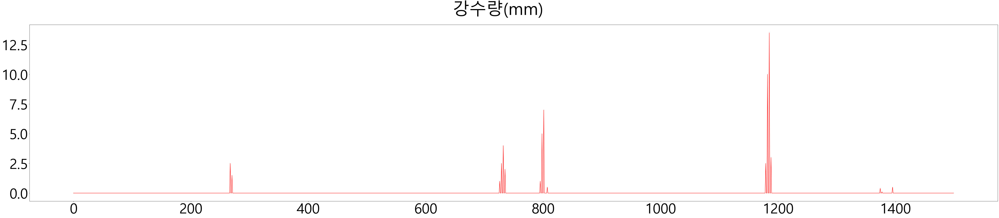

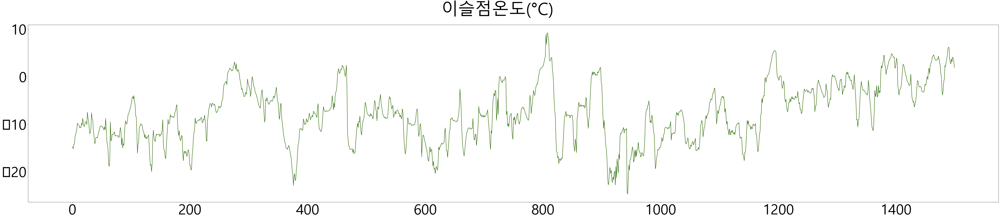

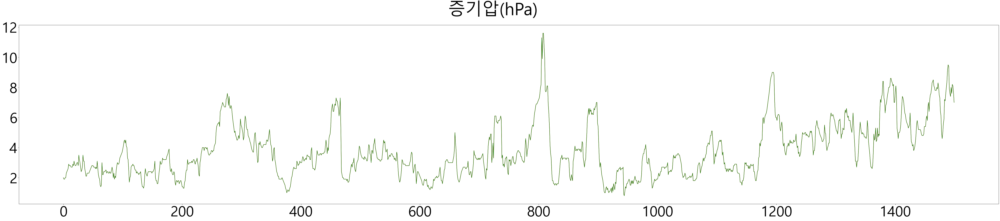

In [150]:
weather_data = check_missing_dates(year, weather_data)
weather_data_2019 = interpolate_weather(weather_data, features)

### all

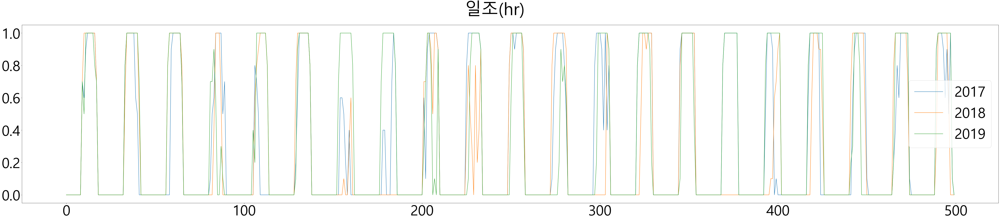

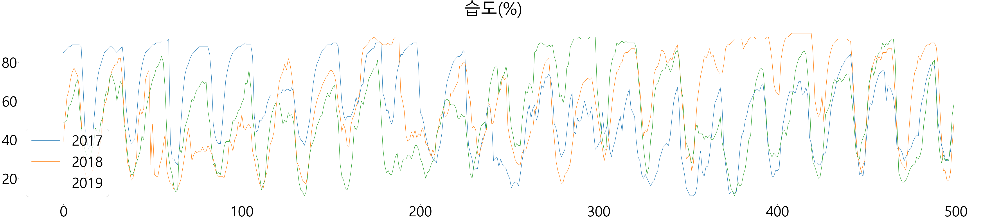

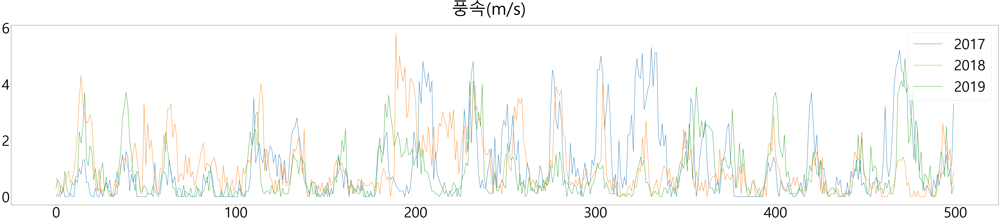

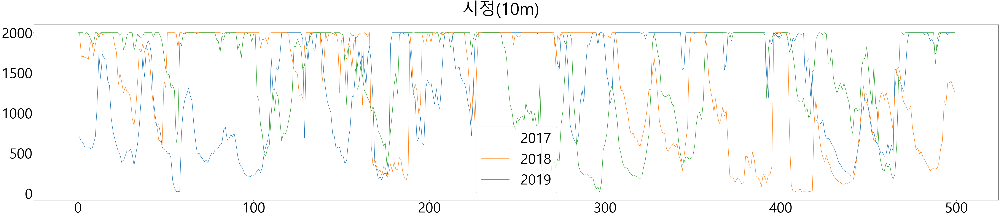

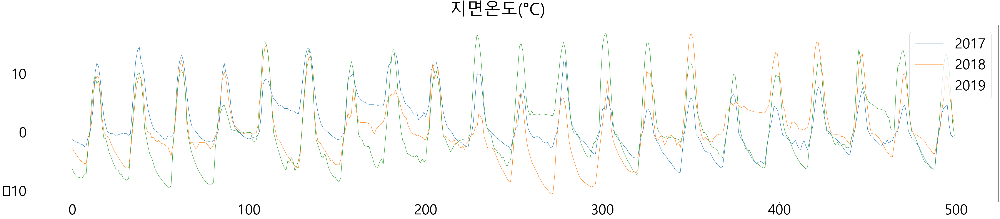

...

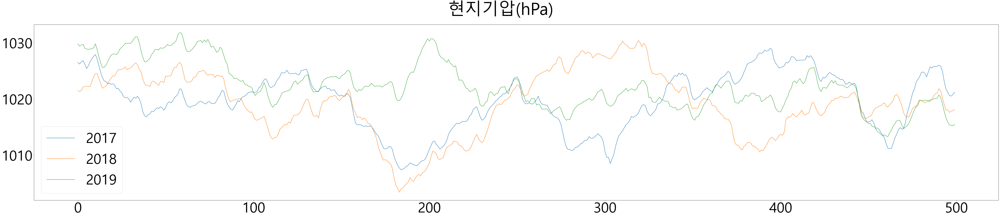

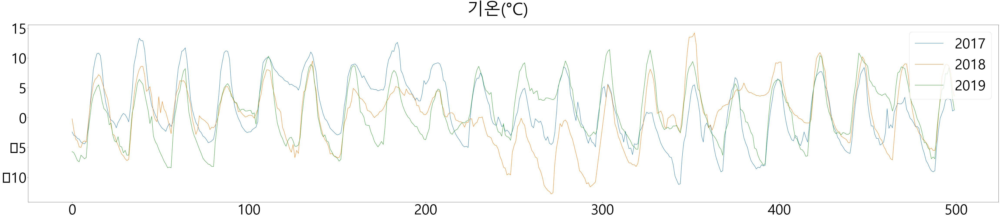

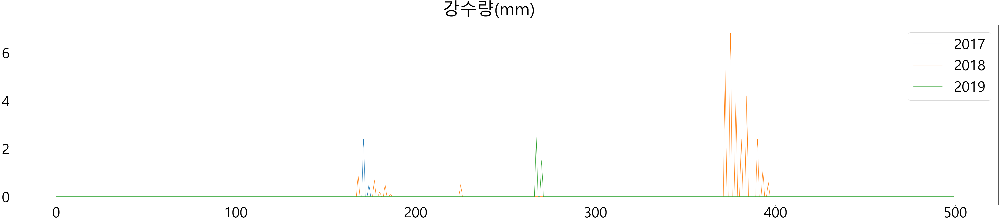

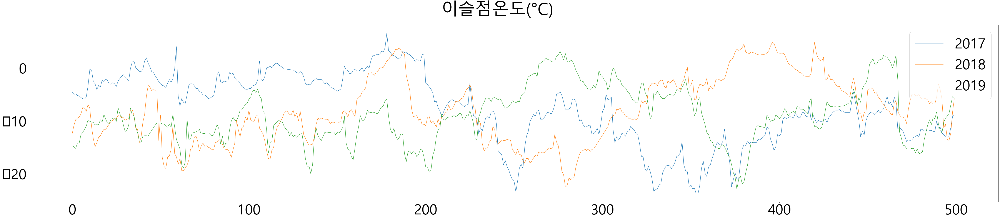

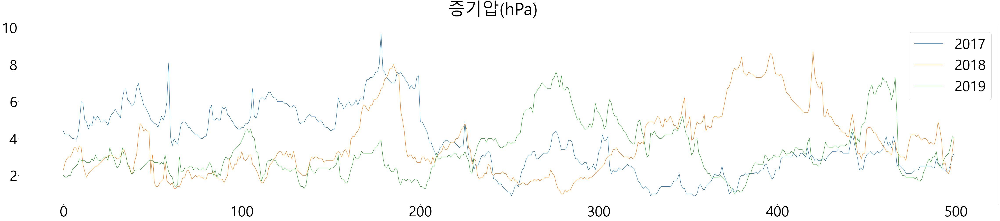

In [156]:
def plot_weather(weathers, features):
    for index, feature in enumerate(features):
        plt.rcParams.update({'font.size': 65})
        plt.figure(figsize=(80, 15))
        for index2, weather_data in enumerate(weathers):
            plt.plot(weather_data[feature.value][:500], label='%d' % (index2 + 2017))
        plt.suptitle(feature.value)
        plt.legend()
        plt.show()       
    
plot_weather([weather_data_2017, weather_data_2018, weather_data_2019], features)